In [1]:
import numpy as np
import caffe
from bs4 import BeautifulSoup
from matplotlib import pyplot as plt
import os

%matplotlib inline

%load_ext autoreload
%autoreload 2

from helpers import *
from heatmaps import *

In [2]:
gpu = 1
net_type = 'googlenet'

caffe.set_device(gpu)
caffe.set_mode_gpu()

net = get_net(net_type)

# for each layer, show the output shape
for layer_name, blob in net.blobs.iteritems():
    print layer_name + '\t' + str(blob.data.shape)

data	(1, 3, 224, 224)
conv1/7x7_s2	(10, 64, 112, 112)
pool1/3x3_s2	(10, 64, 56, 56)
pool1/norm1	(10, 64, 56, 56)
conv2/3x3_reduce	(10, 64, 56, 56)
conv2/3x3	(10, 192, 56, 56)
conv2/norm2	(10, 192, 56, 56)
pool2/3x3_s2	(10, 192, 28, 28)
pool2/3x3_s2_pool2/3x3_s2_0_split_0	(10, 192, 28, 28)
pool2/3x3_s2_pool2/3x3_s2_0_split_1	(10, 192, 28, 28)
pool2/3x3_s2_pool2/3x3_s2_0_split_2	(10, 192, 28, 28)
pool2/3x3_s2_pool2/3x3_s2_0_split_3	(10, 192, 28, 28)
inception_3a/1x1	(10, 64, 28, 28)
inception_3a/3x3_reduce	(10, 96, 28, 28)
inception_3a/3x3	(10, 128, 28, 28)
inception_3a/5x5_reduce	(10, 16, 28, 28)
inception_3a/5x5	(10, 32, 28, 28)
inception_3a/pool	(10, 192, 28, 28)
inception_3a/pool_proj	(10, 32, 28, 28)
inception_3a/output	(10, 256, 28, 28)
inception_3a/output_inception_3a/output_0_split_0	(10, 256, 28, 28)
inception_3a/output_inception_3a/output_0_split_1	(10, 256, 28, 28)
inception_3a/output_inception_3a/output_0_split_2	(10, 256, 28, 28)
inception_3a/output_inception_3a/output_0_spl

In [16]:
labels_desc = np.loadtxt('/home/ruthfong/packages/caffe/data/ilsvrc12/synset_words.txt', str, delimiter='\t')
synsets = np.loadtxt('/home/ruthfong/packages/caffe/data/ilsvrc12/synsets.txt', str, delimiter='\t')
(paths, labels) = read_imdb('/home/ruthfong/packages/caffe/data/ilsvrc12/val_imdb.txt')
data_desc = 'val'
paths = np.array(paths)
labels = np.array(labels)
ann_dir = '/data/ruthfong/ILSVRC2012/val'
ann_paths = np.sort([os.path.join(ann_dir, f) for f in os.listdir(ann_dir)])
res_dir = '/data/ruthfong/neural_coding/pycaffe_results'
mask_rel_dir_top0 = 'googlenet_val_given_grad_1_norm_0/min_top0_prob_blur/lr_-1.00_l1_lambda_-4.00_tv_lambda_-inf_l1_lambda_2_-2.00_beta_3.00_mask_scale_8_blur_mask_5_jitter_4_noise_-inf_num_iters_300_tv2_mask_init'
mask_rel_dir_top5 = 'googlenet_val_given_grad_1_norm_0/min_top5_prob_blur/lr_-1.00_l1_lambda_-3.00_tv_lambda_-inf_l1_lambda_2_-2.00_beta_2.00_mask_scale_8_blur_mask_5_jitter_4_noise_-inf_num_iters_300_tv2_mask_init'
mask_paths_top0 = np.array([os.path.join(res_dir, mask_rel_dir_top0, '%d.npy' % x) for x in range(len(labels))])
mask_paths_top5 = np.array([os.path.join(res_dir, mask_rel_dir_top5, '%d.npy' % x) for x in range(len(labels))])
fig_dir = '/home/ruthfong/neural_coding/paper_figures'

In [4]:
paths[0:10]

array(['/data/datasets/ILSVRC2012/images/val/ILSVRC2012_val_00000001.JPEG',
       '/data/datasets/ILSVRC2012/images/val/ILSVRC2012_val_00000002.JPEG',
       '/data/datasets/ILSVRC2012/images/val/ILSVRC2012_val_00000003.JPEG',
       '/data/datasets/ILSVRC2012/images/val/ILSVRC2012_val_00000004.JPEG',
       '/data/datasets/ILSVRC2012/images/val/ILSVRC2012_val_00000005.JPEG',
       '/data/datasets/ILSVRC2012/images/val/ILSVRC2012_val_00000006.JPEG',
       '/data/datasets/ILSVRC2012/images/val/ILSVRC2012_val_00000007.JPEG',
       '/data/datasets/ILSVRC2012/images/val/ILSVRC2012_val_00000008.JPEG',
       '/data/datasets/ILSVRC2012/images/val/ILSVRC2012_val_00000009.JPEG',
       '/data/datasets/ILSVRC2012/images/val/ILSVRC2012_val_00000010.JPEG'], 
      dtype='|S65')

In [13]:
i = 2
net.blobs['data'].reshape(1,
                  3,
                  net.blobs['data'].data.shape[2],
                  net.blobs['data'].data.shape[3])

net.blobs['data'].data[...] = net_transformer.preprocess('data', caffe.io.load_image(paths[i]))
net.forward()
scores = np.squeeze(net.blobs['prob'].data)
print scores[labels[i]]
print get_short_class_name(np.argmax(scores))

0.771915
Shetland sheepdog


In [19]:
scores_path = '/home/ruthfong/neural_coding/googlenet_pycaffe_val_prob_scores.txt'
correct_path = '/home/ruthfong/neural_coding/googlenet_pycaffe_val_classification_correct.txt'
batch_size = 50

num_imgs = len(labels)
net_transformer = get_ILSVRC_net_transformer(net)
for i in range(int(np.ceil(num_imgs/float(batch_size)))):
    if (i+1)*batch_size < num_imgs:
        idx = range(i*batch_size, (i+1)*batch_size)
    else:
        idx = range(i*batch_size, num_imgs)
    net.blobs['data'].reshape(len(idx),
                          3,
                          net.blobs['data'].data.shape[2],
                          net.blobs['data'].data.shape[3])
    for j in range(len(idx)):
        net.blobs['data'].data[j, ...] = net_transformer.preprocess('data', caffe.io.load_image(paths[idx[j]]))
    net.forward()
    scores = net.blobs['prob'].data
    max_labels = np.argmax(scores, axis=1)
    correct = max_labels == labels[idx]
    f = open(scores_path, 'a')
    np.savetxt(f, scores)
    f.close()
    f = open(correct_path, 'a')
    np.savetxt(f, correct)
    f.close()
    print idx[-1]

net.blobs['data'].reshape(1,
                  3,
                  net.blobs['data'].data.shape[2],
                  net.blobs['data'].data.shape[3])

49
99
149
199
249
299
349
399
449
499
549
599
649
699
749
799
849
899
949
999
1049
1099
1149
1199
1249
1299
1349
1399
1449
1499
1549
1599
1649
1699
1749
1799
1849
1899
1949
1999
2049
2099
2149
2199
2249
2299
2349
2399
2449
2499
2549
2599
2649
2699
2749
2799
2849
2899
2949
2999
3049
3099
3149
3199
3249
3299
3349
3399
3449
3499
3549
3599
3649
3699
3749
3799
3849
3899
3949
3999
4049
4099
4149
4199
4249
4299
4349
4399
4449
4499
4549
4599
4649
4699
4749
4799
4849
4899
4949
4999
5049
5099
5149
5199
5249
5299
5349
5399
5449
5499
5549
5599
5649
5699
5749
5799
5849
5899
5949
5999
6049
6099
6149
6199
6249
6299
6349
6399
6449
6499
6549
6599
6649
6699
6749
6799
6849
6899
6949
6999
7049
7099
7149
7199
7249
7299
7349
7399
7449
7499
7549
7599
7649
7699
7749
7799
7849
7899
7949
7999
8049
8099
8149
8199
8249
8299
8349
8399
8449
8499
8549
8599
8649
8699
8749
8799
8849
8899
8949
8999
9049
9099
9149
9199
9249
9299
9349
9399
9449
9499
9549
9599
9649
9699
9749
9799
9849
9899
9949
9999
10049
10099
10149
1019

In [5]:
correct_path = '/home/ruthfong/neural_coding/googlenet_pycaffe_val_classification_correct.txt'

correct = np.loadtxt(correct_path)
class_acc = np.zeros(1000)

for i in range(1000):
    idx = np.where(labels == i)[0]
    assert(len(idx) == 50)
    class_acc[i] = correct[idx].sum()/float(50)

In [6]:
sorted_idx = np.argsort(class_acc)
print 'worst classes:'
for i in range(10):
    print sorted_idx[i], get_short_class_name(sorted_idx[i]), class_acc[sorted_idx[i]]

print ''
print 'best_classes'
for i in range(10):
    print sorted_idx[-(i+1)], get_short_class_name(sorted_idx[-(i+1)]), class_acc[sorted_idx[-(i+1)]]

worst classes:
782 screen 0.04
836 sunglass 0.08
885 velvet 0.08
618 ladle 0.18
899 water jug 0.18
838 sunscreen 0.18
620 laptop 0.2
266 miniature poodle 0.2
282 tiger cat 0.2
744 projectile 0.2

best_classes
255 Leonberg 1.0
995 earthstar 1.0
9 ostrich 0.98
986 yellow lady's slipper 0.98
376 proboscis monkey 0.98
275 African hunting dog 0.98
576 gondola 0.98
11 goldfinch 0.98
24 great grey owl 0.98
129 spoonbill 0.98


In [7]:
scores_path = '/home/ruthfong/neural_coding/googlenet_pycaffe_val_prob_scores.txt'
scores = np.loadtxt(scores_path)

In [19]:
def show_imgs(net_transformer, paths, mask_paths, scores, correct = None, fig_path = None):
    pylab.rcParams['figure.figsize'] = (20.0, 10.0)
    f, ax = plt.subplots(5,10)
    assert(len(paths) == 50 and len(mask_paths) == 50 and len(scores) == 50)
    if correct is not None:
        assert(len(correct) == 50)
    sorted_idx = np.argsort(scores)
    for i in range(50):
        ax[i/10][i%10].imshow(net_transformer.deprocess('data',
                                                        net_transformer.preprocess('data', 
                                                        caffe.io.load_image(paths[sorted_idx[i]]))))
        ax[i/10][i%10].imshow(np.load(mask_paths[sorted_idx[i]]), alpha = 0.5, cmap='jet')
        if correct is not None:
            if correct[i]:
                ax[i/10][i%10].set_title('%.3f (C)' % scores[sorted_idx[i]])
            else:
                ax[i/10][i%10].set_title('%.3f (I)' % scores[sorted_idx[i]])
        else:
            ax[i/10][i%10].set_title('%.3f' % scores[sorted_idx[i]])
        ax[i/10][i%10].get_xaxis().set_visible(False)
        ax[i/10][i%10].get_yaxis().set_visible(False)
    if fig_path is not None:
        plt.savefig(fig_path, bbox_inches='tight', pad_inches=0.0)

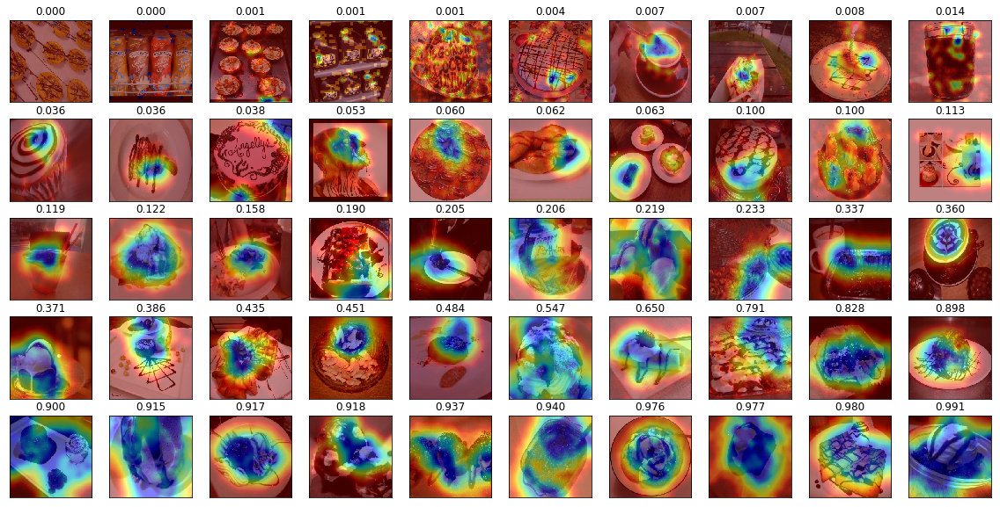

In [14]:
%matplotlib inline
net_transformer = get_ILSVRC_net_transformer(net)
label = 960 # chocolate sauce
idx = np.where(labels == label)[0]
sub_scores = np.squeeze(scores[idx])
sub_scores = sub_scores[:,label]
show_imgs(net_transformer, paths[idx], mask_paths_top0[idx], sub_scores)

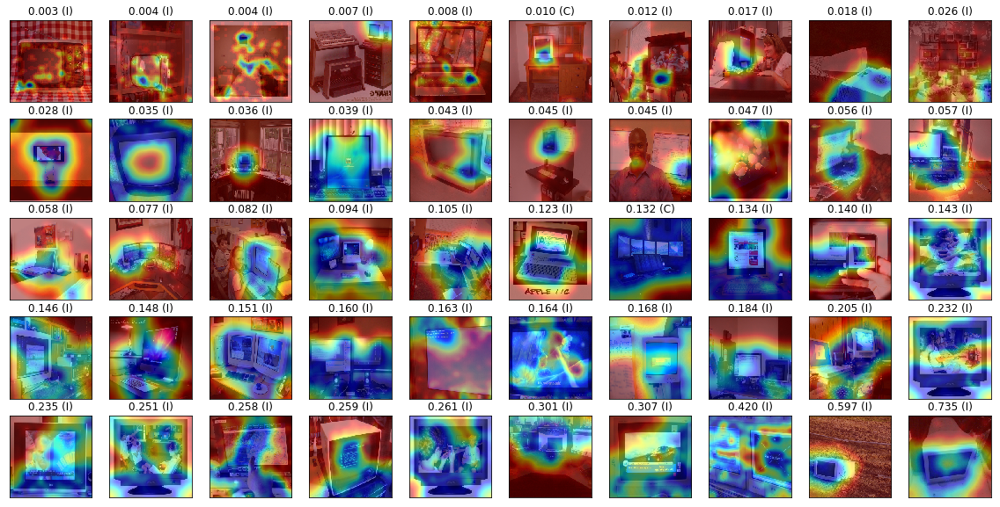

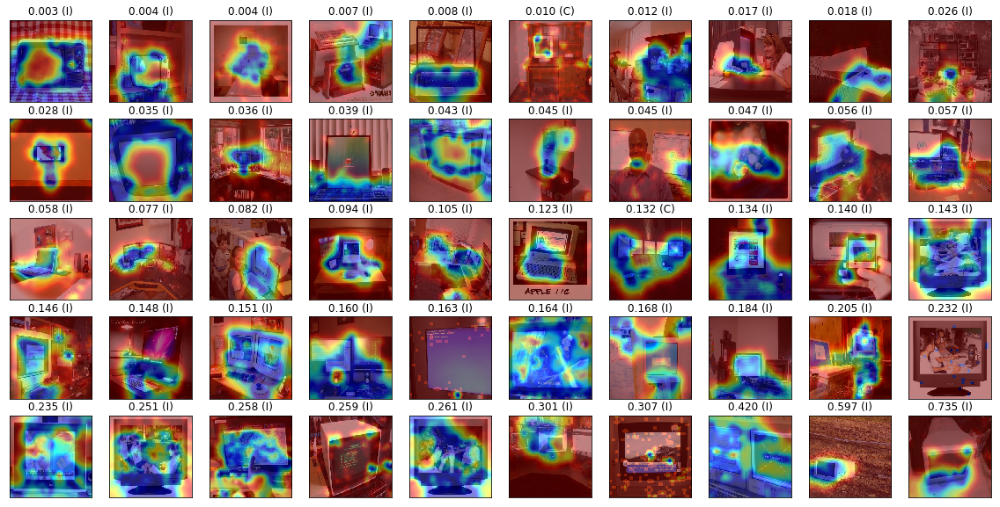

In [13]:
%matplotlib inline
net_transformer = get_ILSVRC_net_transformer(net)
label = 782 # screen
idx = np.where(labels == label)[0]
sub_correct = correct[idx]
sub_scores = np.squeeze(scores[idx])
sub_scores = sub_scores[:,label]
show_imgs(net_transformer, paths[idx], mask_paths_top0[idx], sub_scores, sub_correct)
show_imgs(net_transformer, paths[idx], mask_paths_top5[idx], sub_scores, sub_correct)

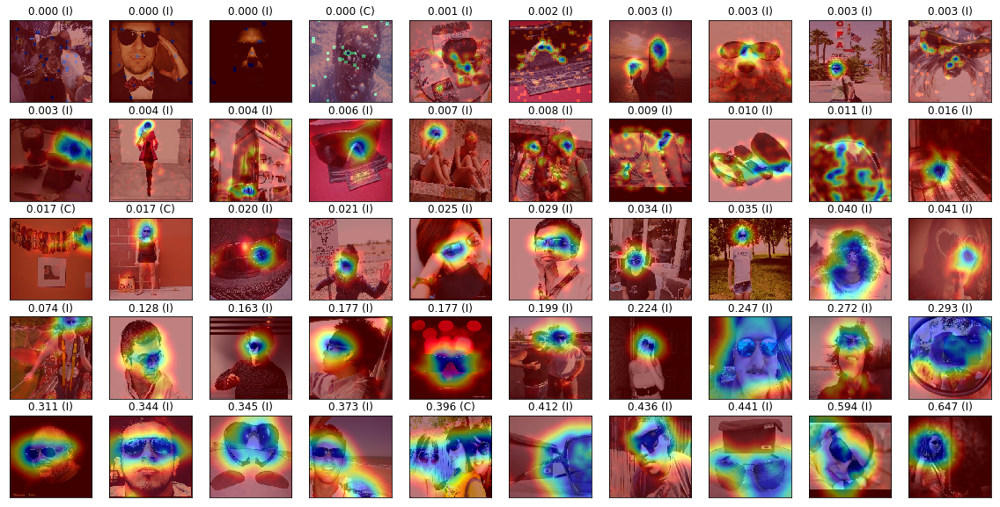

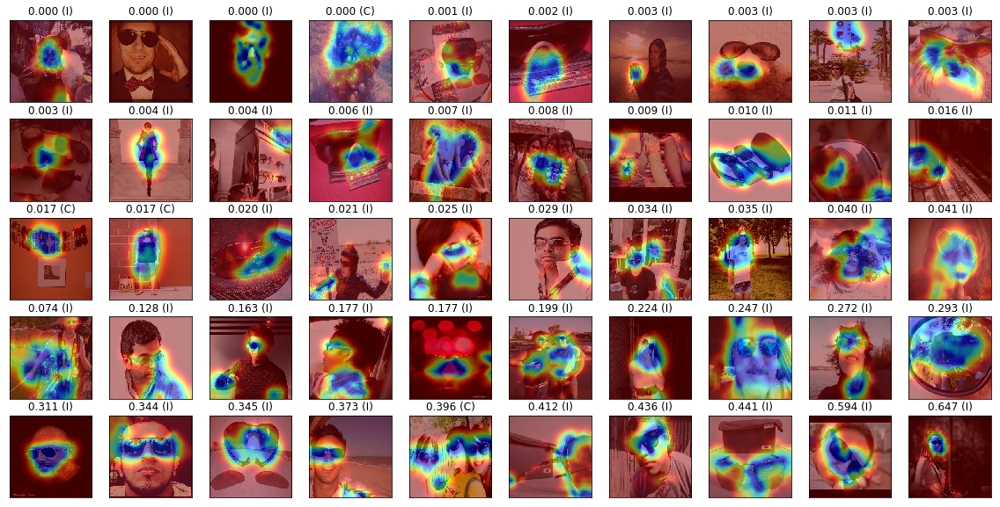

In [14]:
label = 836 # sunglasses
idx = np.where(labels == label)[0]
sub_correct = correct[idx]
sub_scores = np.squeeze(scores[idx])
sub_scores = sub_scores[:,label]
show_imgs(net_transformer, paths[idx], mask_paths_top0[idx], sub_scores, sub_correct)
show_imgs(net_transformer, paths[idx], mask_paths_top5[idx], sub_scores, sub_correct)

782 screen 0.04
836 sunglass 0.08
885 velvet 0.08
618 ladle 0.18
899 water jug 0.18
838 sunscreen 0.18
620 laptop 0.2
266 miniature poodle 0.2
282 tiger cat 0.2
744 projectile 0.2


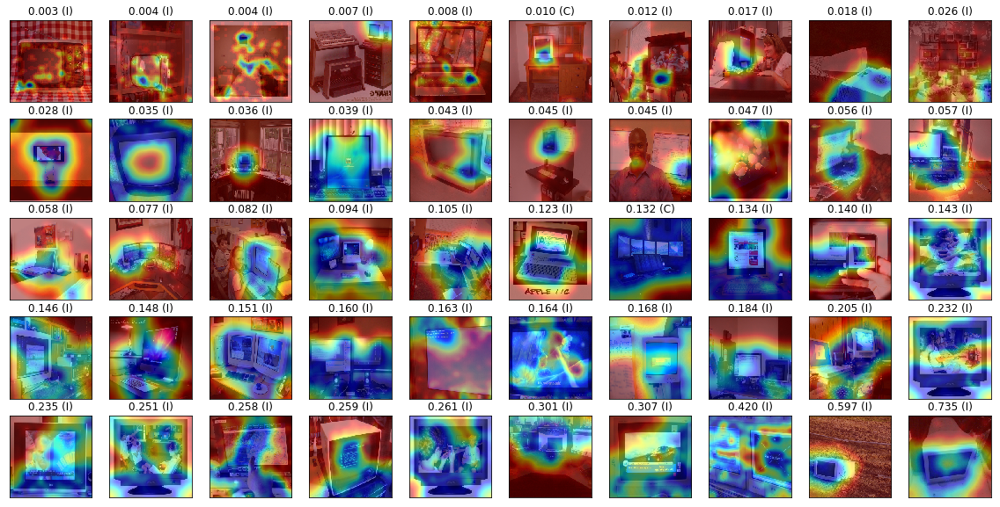

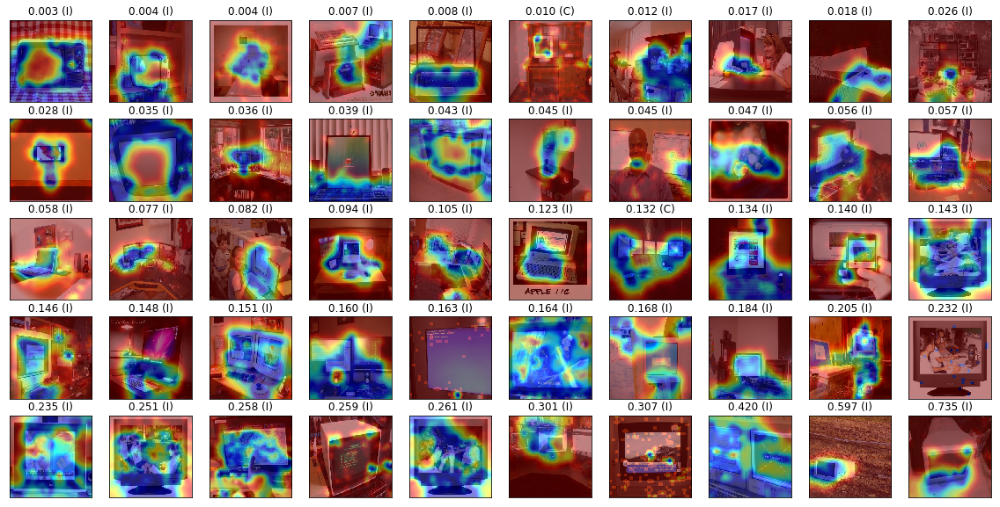

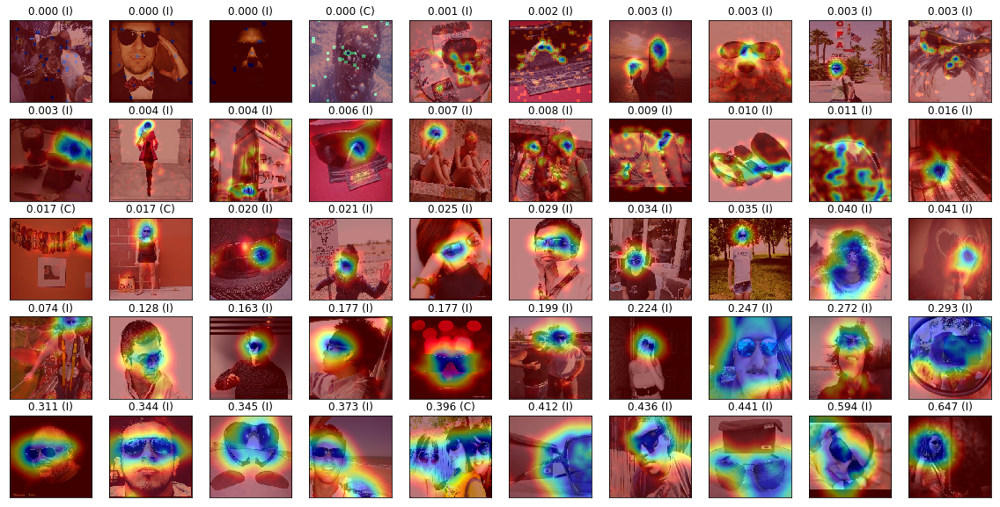

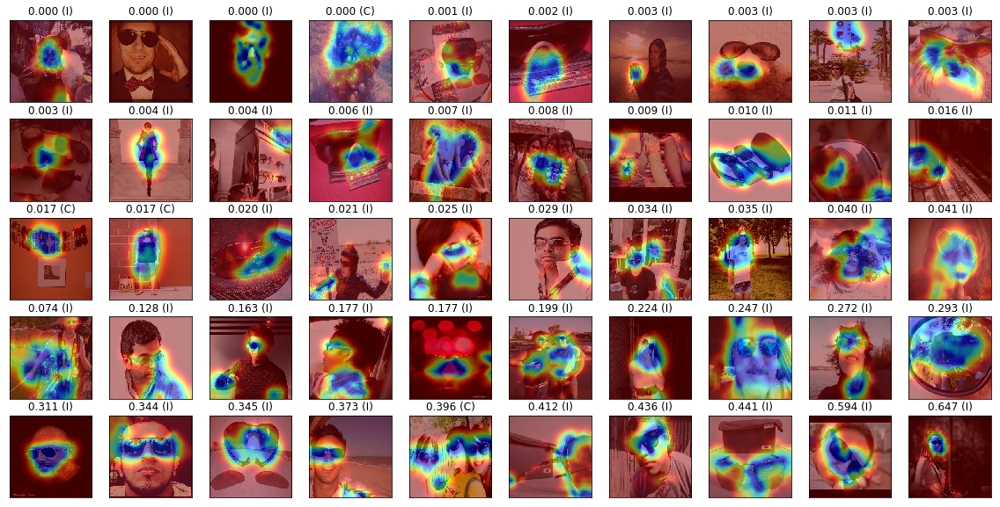

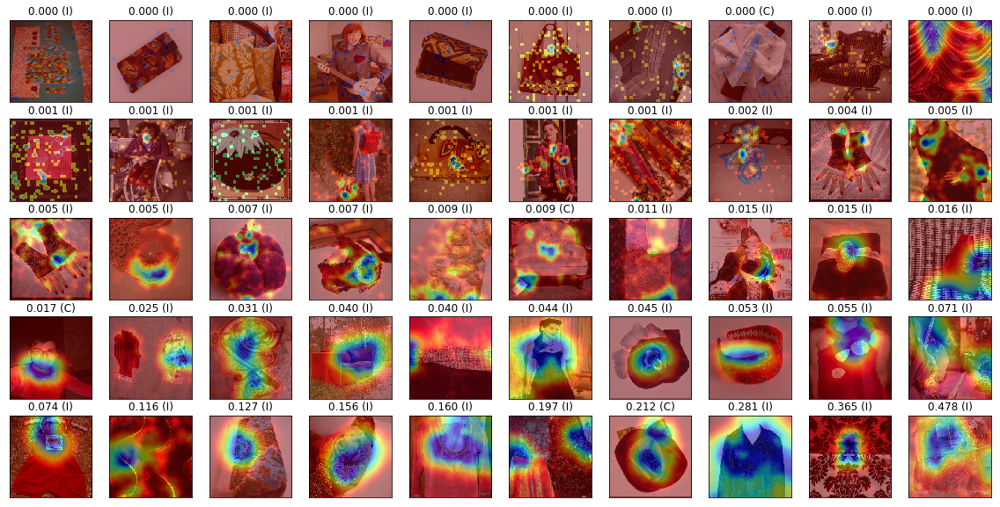

...

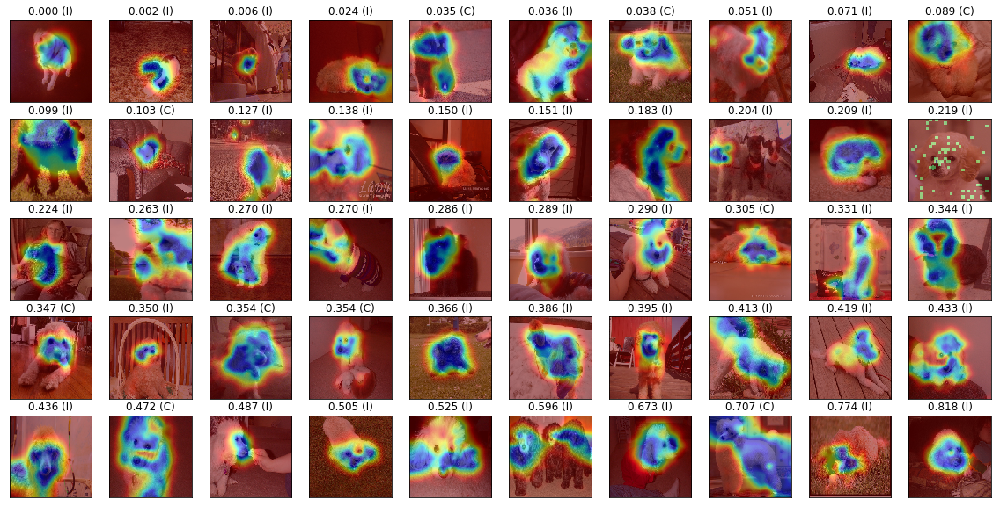

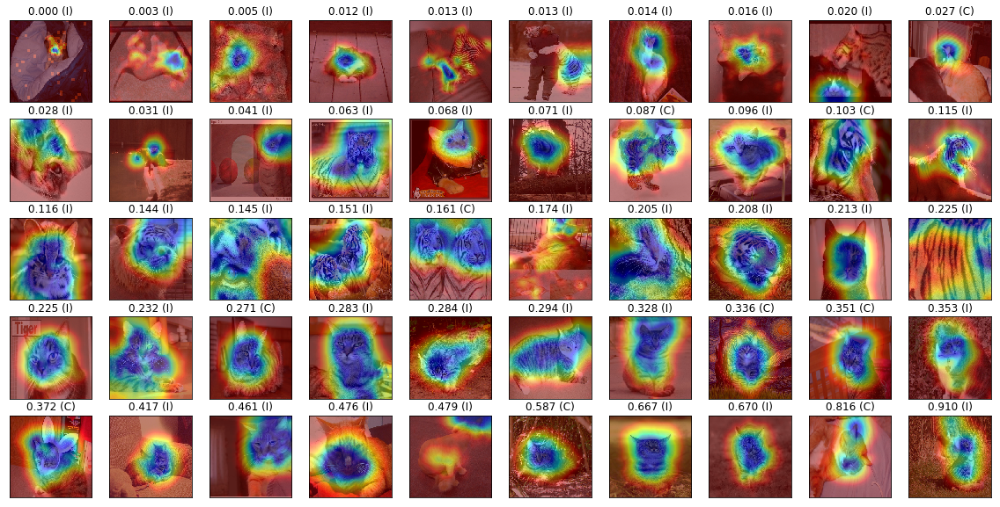

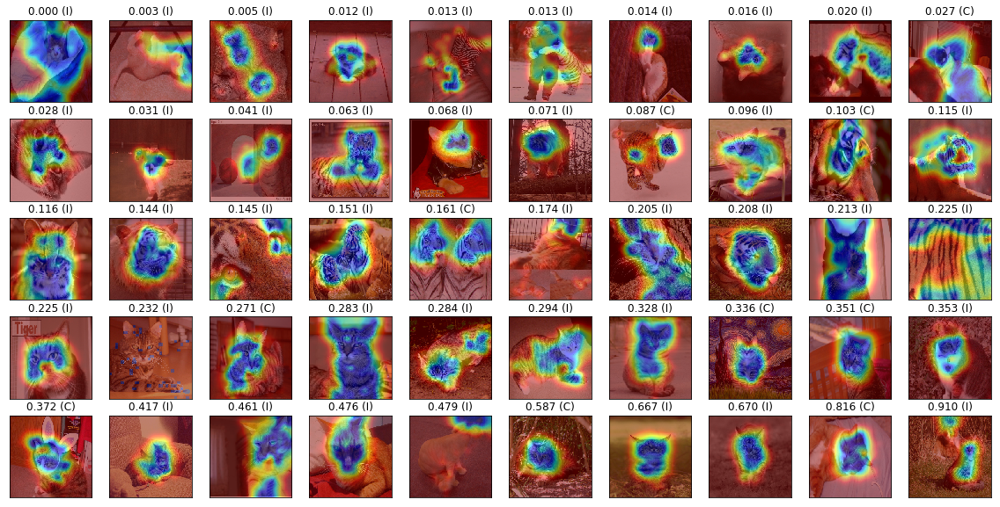

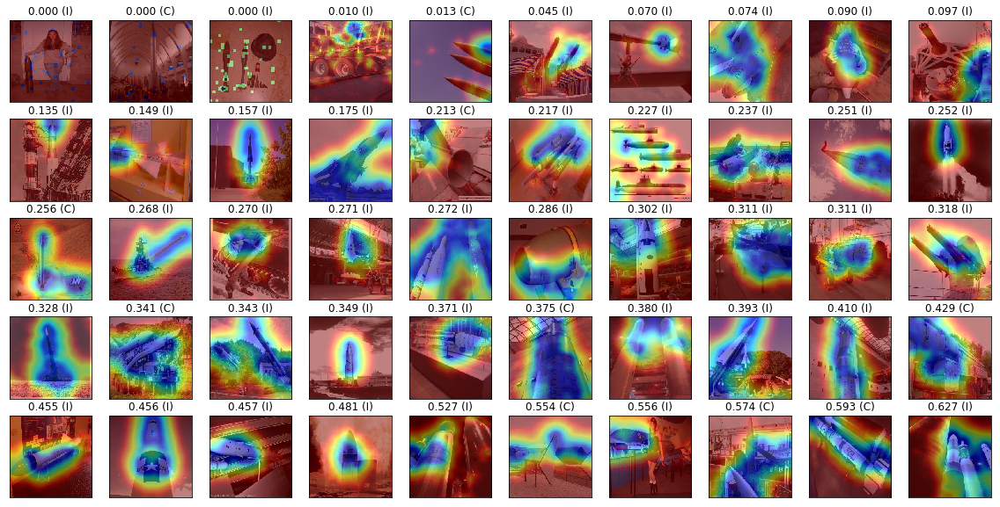

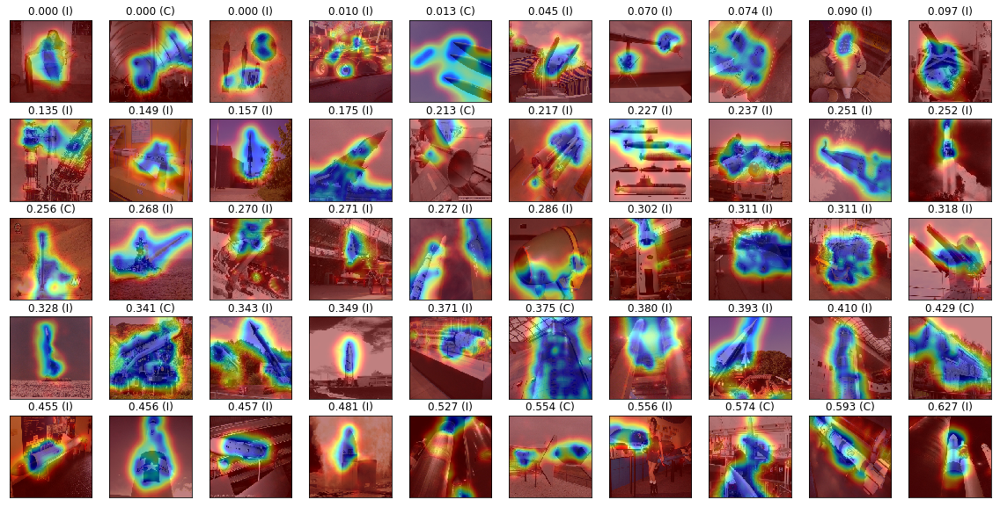

In [20]:
for i in range(10):
    print sorted_idx[i], get_short_class_name(sorted_idx[i]), class_acc[sorted_idx[i]]
    label = sorted_idx[i]
    idx = np.where(labels == label)[0]
    sub_scores = np.squeeze(scores[idx])
    sub_scores = sub_scores[:,label]
    sub_correct = correct[idx]
    fig_path = os.path.join(fig_dir, 'class_%d_masks_top0.pdf' % label)
    show_imgs(net_transformer, paths[idx], mask_paths_top0[idx], sub_scores, sub_correct, fig_path)
    fig_path = os.path.join(fig_dir, 'class_%d_masks_top5.pdf' % label)
    show_imgs(net_transformer, paths[idx], mask_paths_top5[idx], sub_scores, sub_correct, fig_path)